# Importar Librerias #

In [1]:
#instalando librosa#

! pip install librosa

In [40]:
import numpy as np
import matplotlib.pyplot as plt
import os
import librosa
import librosa.display
import IPython.display as ipd

# Cargar dirección audios #

In [24]:
#"./articulos_ml.csv"
#BASE_DIR = "./articulos_ml.csv"

violin_ND_file = "./92002__jcveliz__violin-origional.wav"
sax_G3_file = "./sax.wav"
violin_C4_file = "./violin-c4.wav"
cello_Scale_file = "./cello-am-scale.wav"

## En VS code el sonido no se reproduce en el notebook ##

In [3]:
ipd.Audio(violin_ND_file)

In [4]:
ipd.Audio(sax_G3_file)

In [5]:
ipd.Audio(violin_C4_file)

In [25]:
ipd.Audio(cello_Scale_file)

# Manipulación librosa (Fecuencias)#

In [26]:
violin_ND, sr =librosa.load(violin_ND_file)
sax_G3, sr =librosa.load(sax_G3_file)
violin_C4, sr =librosa.load(violin_C4_file)
cello_Scale, sr =librosa.load(cello_Scale_file)

In [27]:
print(violin_ND.shape)
print(sax_G3.shape)
print(violin_C4.shape)
print(cello_Scale.shape)

(110250,)
(118784,)
(69656,)
(1238361,)


## Grafica de tiempo ##

<function matplotlib.pyplot.show(*args, **kw)>

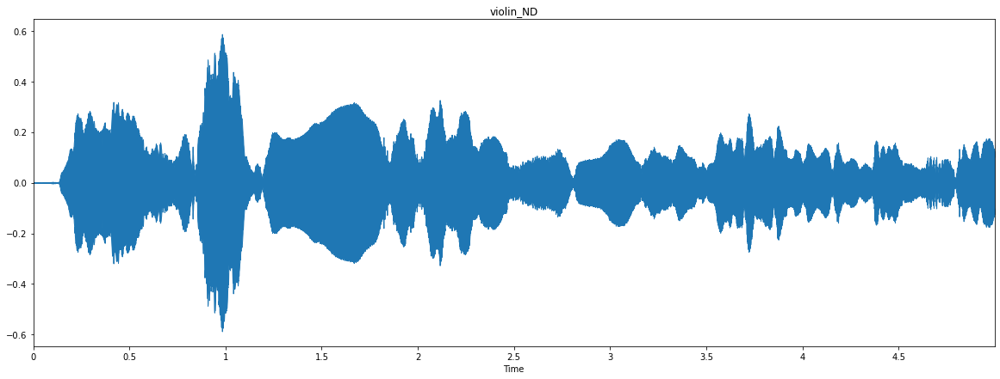

In [8]:
plt.figure(figsize=(20,7))
librosa.display.waveplot(violin_ND)
plt.title("violin_ND")
plt.show

<function matplotlib.pyplot.show(*args, **kw)>

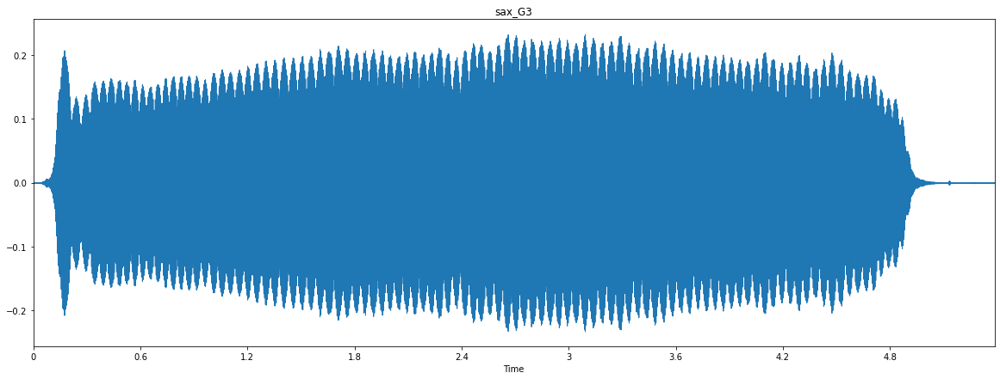

In [9]:
plt.figure(figsize=(20,7))
librosa.display.waveplot(sax_G3)
plt.title("sax_G3")
plt.show

<function matplotlib.pyplot.show(*args, **kw)>

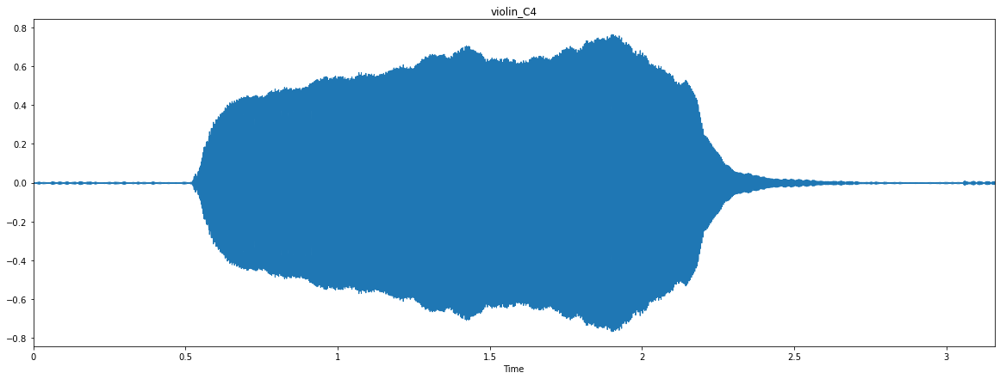

In [10]:
plt.figure(figsize=(20,7))
librosa.display.waveplot(violin_C4)
plt.title("violin_C4")
plt.show

<function matplotlib.pyplot.show(*args, **kw)>

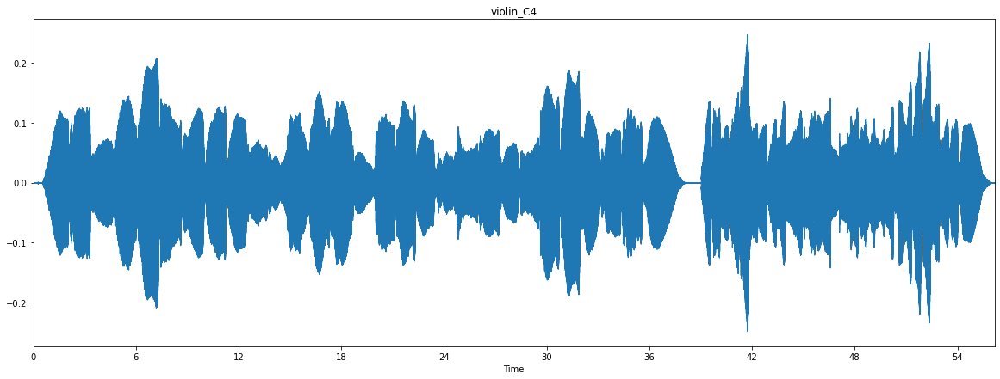

In [28]:
plt.figure(figsize=(20,7))
librosa.display.waveplot(cello_Scale)
plt.title("violin_C4")
plt.show

## Transformada Fourier ##

In [29]:
FT_violin_ND = np.fft.fft(violin_ND)
FT_sax_G3 = np.fft.fft(sax_G3)
FT_violin_C4 = np.fft.fft(violin_C4)
FT_cello_Scale = np.fft.fft(cello_Scale)

In [12]:
print(violin_C4.shape)
print(FT_violin_C4[0])

(69656,)
(-0.4046102894100157+1.8096635301390052e-14j)


In [13]:
MagnitudeSpectrum_violin_C4 = np.abs(FT_violin_C4)
MagnitudeSpectrum_violin_C4[0]

0.4046102894100157

In [14]:
def plot_magnitude_spectrum(signal, title, sr,f_ratio=1):
    ft=np.fft.fft(signal)
    magnitude_spectrum = np.abs(ft)
    
    #plot magnitude spectrum
    plt.figure(figsize=(20,7))
    
    frequency = np.linspace(0,sr,len(magnitude_spectrum))
    num_frequency_bins = int(len(frequency)*f_ratio)
    
    plt.plot(frequency[:num_frequency_bins], magnitude_spectrum[:num_frequency_bins])
    plt.xlabel("Frequency (Hz)")
    plt.title(title)
    
    plt.show
    

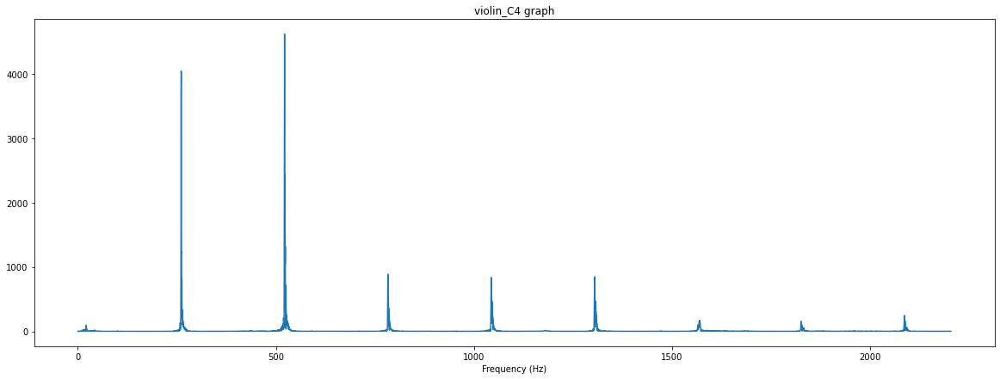

In [15]:
plot_magnitude_spectrum(violin_C4, "violin_C4 graph", sr, 0.1)


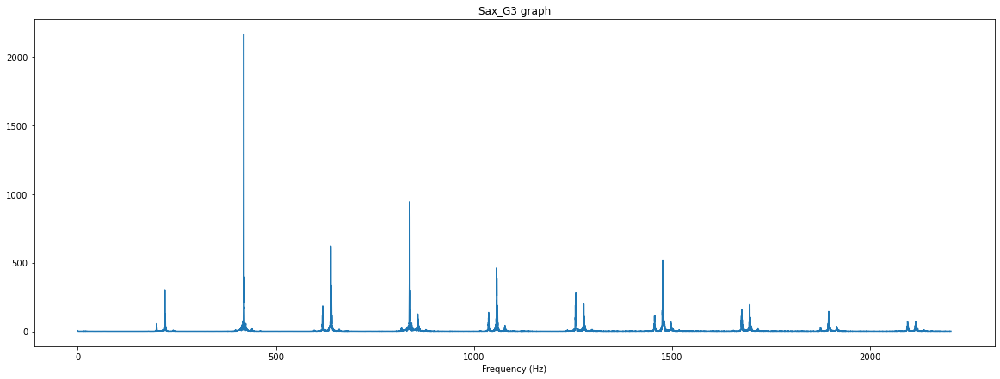

In [16]:
plot_magnitude_spectrum(sax_G3, "Sax_G3 graph", sr, 0.1)

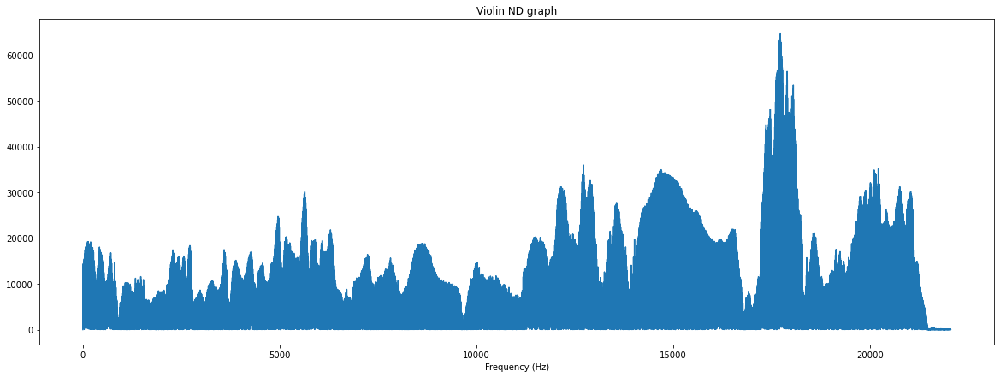

In [17]:
plot_magnitude_spectrum(FT_violin_ND, "Violin ND graph", sr, 1)

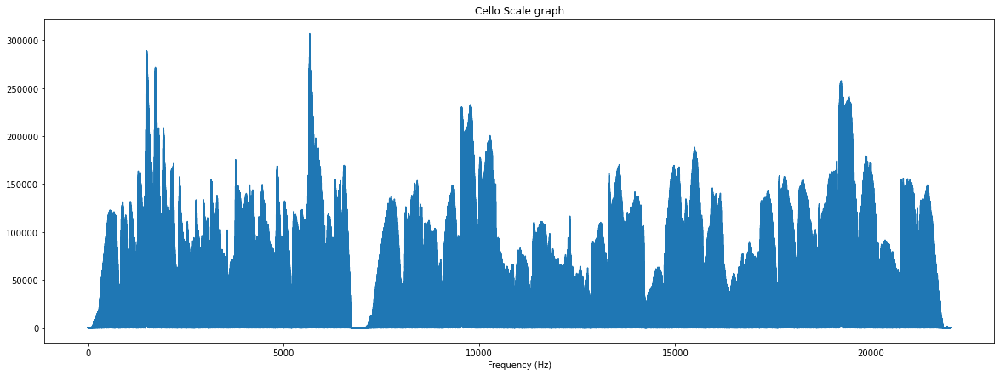

In [30]:
plot_magnitude_spectrum(FT_cello_Scale, "Cello Scale graph", sr, 1)

## Extraer short-time transformada fourier ##

In [31]:
FRAME_SIZE = 2048
HOP_SIZE = 512

In [49]:
S_violin_ND = librosa.stft(violin_ND, n_fft=FRAME_SIZE, hop_length=HOP_SIZE)
S_sax_G3 = librosa.stft(sax_G3, n_fft=FRAME_SIZE, hop_length=HOP_SIZE)
S_violin_C4 = librosa.stft(violin_C4, n_fft=FRAME_SIZE, hop_length=HOP_SIZE)
S_cello_Scale = librosa.stft(cello_Scale, n_fft=FRAME_SIZE, hop_length=HOP_SIZE)

## Calcular el espectograma ##

In [57]:
Y_violin_ND = np.abs(S_violin_ND)**2
Y_sax_G3 = np.abs(S_sax_G3)**2
Y_violin_C4 = np.abs(S_violin_C4)**2
Y_cello_Scale = np.abs(S_cello_Scale)**2

print(Y_violin_ND.shape)
print(Y_sax_G3.shape)
print(Y_violin_C4.shape)
print(Y_cello_Scale.shape)

type(Y_violin_ND[0][0])

(1025, 216)
(1025, 233)
(1025, 137)
(1025, 2419)


numpy.float32

## Visulaizar espectograma ##

In [76]:
def plot_spectrogram(Y, sr, hop_length, y_axis="linear"):
    plt.figure(figsize=(15, 5))
    librosa.display.specshow(Y,sr=sr,hop_length=hop_length,x_axis="time",y_axis=y_axis)
    plt.colorbar(format="%+2.f")

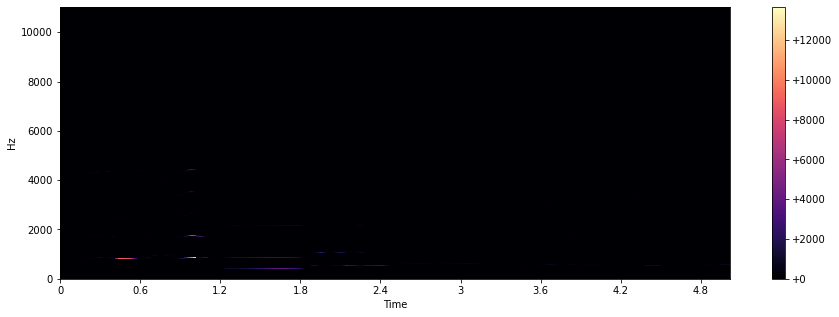

In [77]:
plot_spectrogram(Y_violin_ND,sr,HOP_SIZE)

In [70]:
# para borrar variables o funciones= del plot_spectogram

In [82]:
Ylog_violin_ND = librosa.power_to_db(Y_violin_ND)
Ylog_sax_G3 = librosa.power_to_db(Y_sax_G3)
Ylog_violin_C4 = librosa.power_to_db(Y_violin_C4)
Ylog_cello_Scale = librosa.power_to_db(Y_cello_Scale)

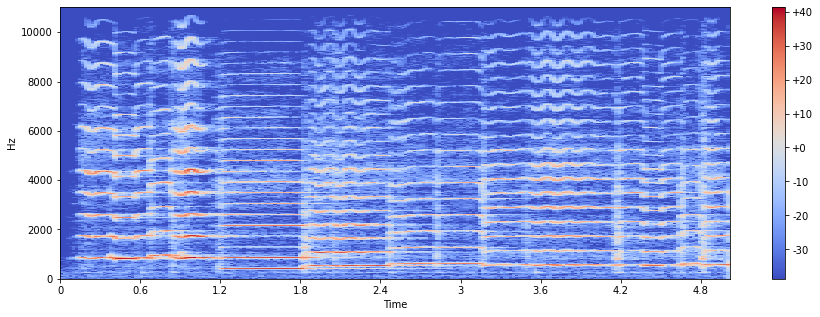

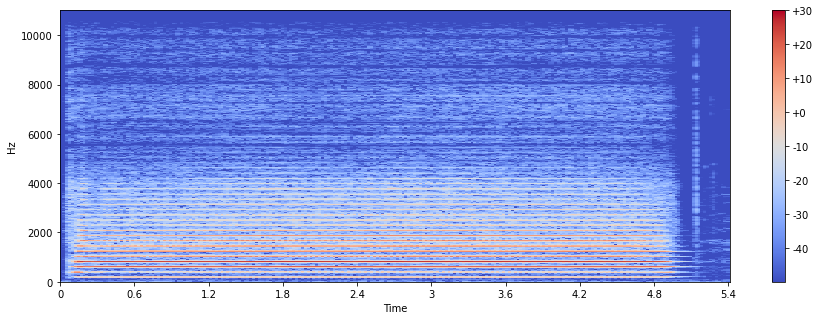

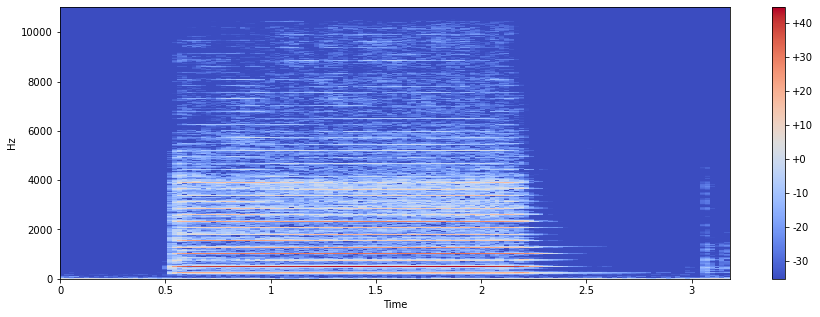

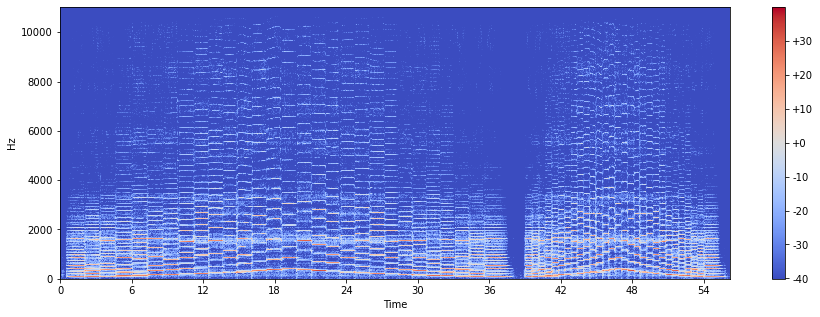

In [83]:
plot_spectrogram(Ylog_violin_ND,sr,HOP_SIZE)
plot_spectrogram(Ylog_sax_G3,sr,HOP_SIZE)
plot_spectrogram(Ylog_violin_C4,sr,HOP_SIZE)
plot_spectrogram(Ylog_cello_Scale,sr,HOP_SIZE)